# 이미지 변형


자 그 다음에 우리가 지금까지는 계속 어떤 픽셀의 밝기나 색깔을 바꾸는 방식으로 이미지를 처리를 했는데요 이미지의 모양을 바꾸는 쪽으로 한번 해보도록 하겠습니다

이번 시간에는 이미지 변형 이미지의 모양을 바꾸는 거에 가장 기본은 뒤집거나 돌리거나 이런 건데요 뒤집는 함수는 플립입니다

In [1]:
#!hide
from PIL import Image
import cv2
import os
def show(image):
    rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB) # BGR → RGB로 채널 순서 변경
    return Image.fromarray(rgb) # 객체 변환: 넘파이 배열 → PIL 형식으로
os.chdir('data')

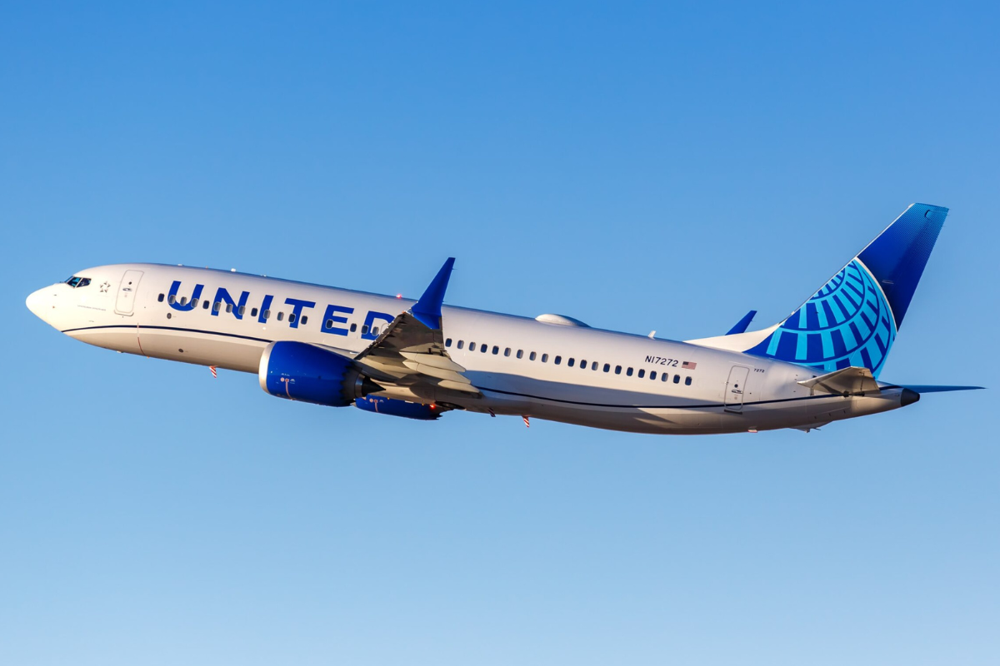

In [19]:
import cv2
image = cv2.imread('plane.webp')
show(image)

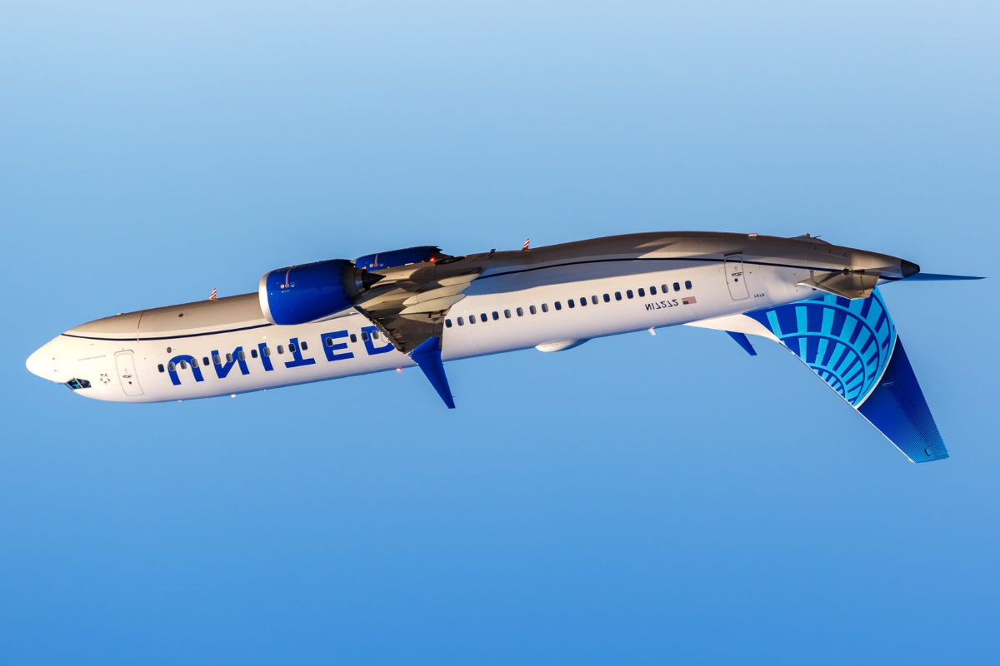

In [3]:
show(cv2.flip(image, 0))

이거를 0 이렇게 하면은 상하로 뒤집거든요

그래서 상하로 뒤집으면 비행기가 왼쪽을 보고 있긴 한데 위아래가 바뀌어 있죠

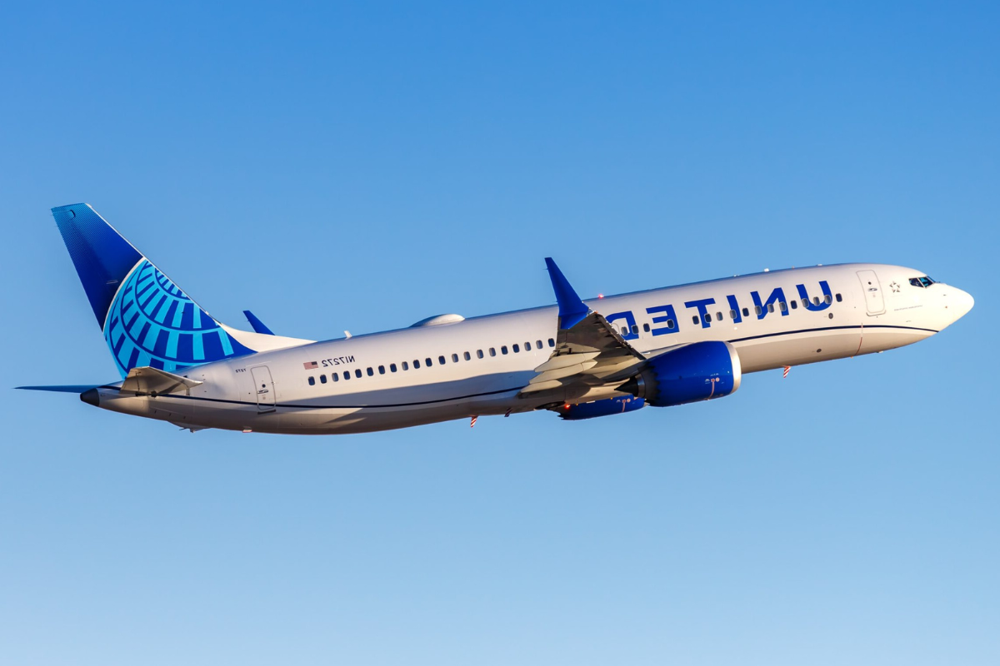

In [4]:
show(cv2.flip(image, 1))

그래서 이렇게 플립을 하면은 이미지가 이제 뒤집히게 되고 그래서 요거를 이제 좌우로 뒤집고 싶으면 0이 아니라 1로 하시면 됩니다

1로 하면은 이제 비행기가 왼쪽을 보는게 오른쪽으로 보고 있죠

그래서 이제 보시면 글자가 United가 뒤집혀 있어요 거울에 비친 것처럼 됩니다

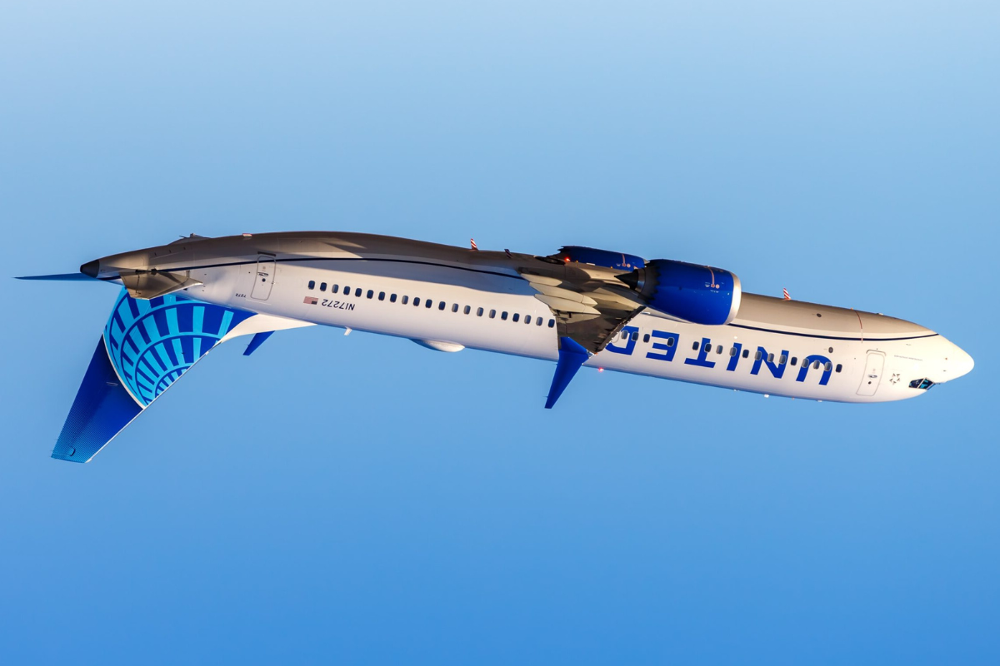

In [5]:
show(cv2.flip(image, -1))

그 다음에 여기를 마이너스 1로 하면은 상하좌우를 다 뒤집어 줘요

그래서 위아래도 뒤집혀 있고 좌우도 뒤집혀져 있고 지금 여기가 이제 슬라이드 68쪽 입니다

이미지는 여러분이 원하시는 걸 열어서 해보시면 되는데요

## 회전

회전을 먼저 해보면 회전은 별거 아니고 그 사진을 돌리는 거죠

사진을 돌리는 건데 일단 이미지의 모양을 알아야 됩니다

In [20]:
height, width, channel = image.shape  # 이미지의 높이, 너비, 채널 수
height, width, channel

(800, 1200, 3)

In [32]:
cX, cY = width // 2, height // 2
angle = 90
ratio = 1
matrix = cv2.getRotationMatrix2D((cX, cY), angle, ratio)
matrix

array([[ 6.123234e-17,  1.000000e+00,  2.000000e+02],
       [-1.000000e+00,  6.123234e-17,  1.000000e+03]])

그 다음에 이제 우리가 이미지의 중심을 알아야 되는데 이미지의 중심은 높이를 반으로 자르고 넓이를 반으로 자르면 되는데 좌표는 가로 세로 순으로 하기 때문에 위스가 먼저 나와야 됩니다

그래서 여기가 이제 중심 좌표가 되고요 그 다음에 이제 우리가 회전 각도를 얼마로 할 거냐

그러면은 90도를 돌리겠다

90도 그 다음에 이제 뭐 회전하는 김에 확대나 축소를 할 거냐

안 할 거다

그럼

1대1로 하면 되겠죠?

그 다음에 이제 여기 get rotation matrix 2D라는 함수가 있는데요

이 함수는 여기를 중심으로 90도를 1대1로 회전하는 그 수학적인 행렬을 만들어줘요

센터 앵글 레이셔를 집어넣으면 매트릭스를 보시면 이런 행렬이 나오게 됩니다

그래서 이 행렬을 이제 적용을 하면은 이미지에다 적용을 하면은 그 이미지를 이제 회전을 시킬 수가 있어요

In [ ]:
import numpy as np
cos = np.abs(matrix[0, 0])
sin = np.abs(matrix[0, 1])

nW = int((height * sin) + (width * cos)) # 새로운 너비
nH = int((height * cos) + (width * sin)) # 새로운 높이

matrix[0, 2] += (nW / 2) - cX # x축 이동
matrix[1, 2] += (nH / 2) - cY # y축 이동

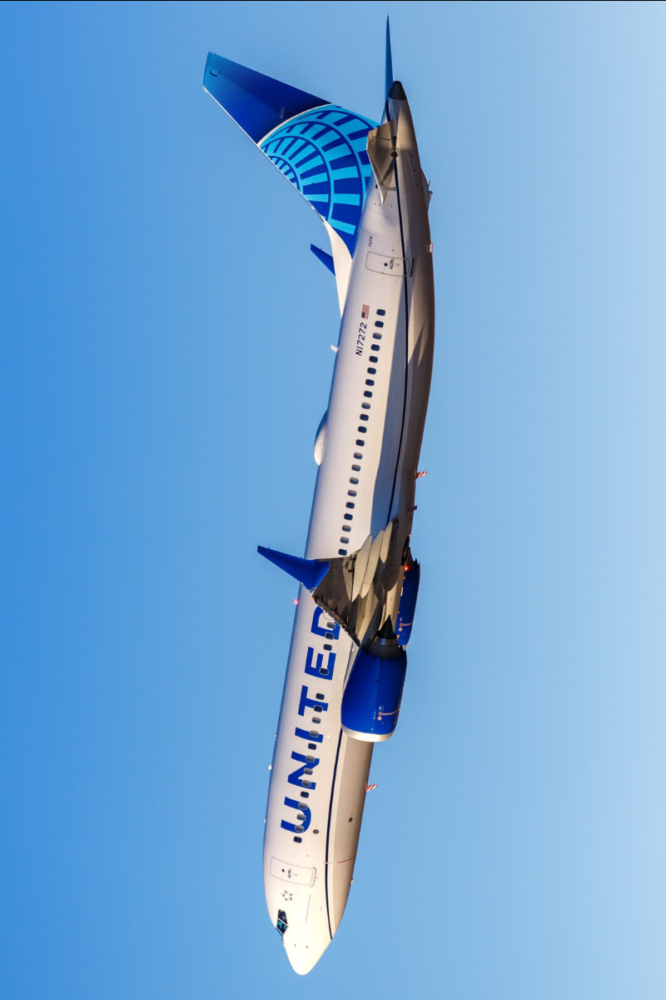

In [34]:
rotated = cv2.warpAffine(image, matrix, (nW, nH))  # 이미지 회전
show(rotated)

그래서 실제로 회전을 시키는 함수는 warp affine 이걸 이제 적용을 하시면 되는데요

그래서 이 이미지에다가 회전 행렬을 적용을 해 주시면 되고 여기에는 이제 이미지에 변환된 크기를 넣어주시면 됩니다.

그래서 show rotated 이렇게 하면은 이미지가 이렇게 90도 돌아가 있죠

그래서 비행기가 멀쩡히 날아가다가 이렇게 추락을 하는데요

## 체스 보드

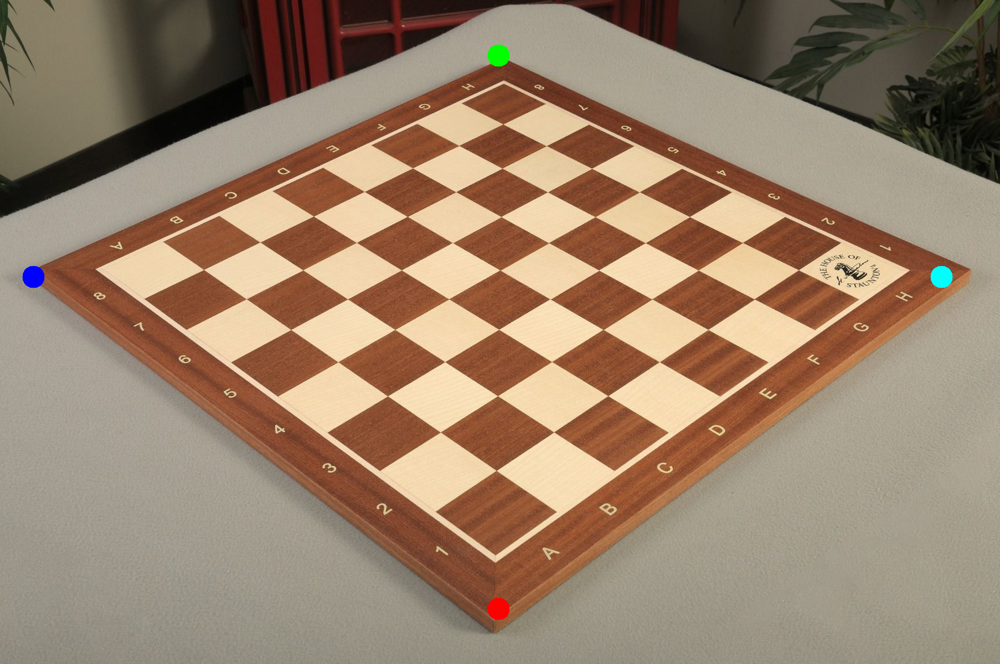

In [10]:
import numpy as np
src = cv2.imread('chessboard.jpg')

pts1 = np.array([[60, 500],[900, 100],[900,1100], [1700, 500]], dtype=int)
pts2 = np.float32([[0,0],[1000,0],[0,1000], [1000, 1000]])

cv2.circle(src, tuple(pts1[0]), 20, (255,0,0),-1)
cv2.circle(src, tuple(pts1[1]), 20, (0,255,0),-1)
cv2.circle(src, tuple(pts1[2]), 20, (0,0,255),-1)
cv2.circle(src, tuple(pts1[3]), 20, (255,255,0),-1)
show(src)


## 아핀 변환

아핀 변환이라는 게 있습니다

아핀은 사람 이름이에요

아핀 변환은 뭐냐면 오른쪽에 보시면은 아핀 변환의 예시가 있는데 영상의 트랜슬레이션 트랜슬레이션은 뭐냐면 위치를 이동을 하는 겁니다

여기 있던 영상을 평행하게 이쪽으로 옮기거나 아니면 이제 쉬어는 영상이 이렇게 반듯하게 있었는데 영상을 이렇게 찌그러뜨리는 거야

찌그러뜨리거나 아니면은 회전을 시키거나 반듯하게 있었던 사진을 돌리는 거죠

이렇게 그 다음에 스케일링 영상을 잡아 늘리거나 줄이거나 이런 거를 이걸 다 합치면 이제 이런 식으로 되겠죠

그래서 이런 거를 합친 거를 아핀 변환이라고 합니다

그래서 이 아핀 변환은 그 아까 앞에서 보셨던 거 같이 어떤 행렬이 있어서 요 행렬을 적용하는 형식으로 변환을 하는데 그래서 이제 요 회전도 아핀 변환의 일종이기 때문에 우리가 이제 여기 Get Rotation Method에 있는 게 있습니다.

Get Rotation Matrix 2D 요게 요런 회전을 하려면 아핀 변환에서 어떤 행렬을 적용하면 되느냐 그 행렬을 계산을 해줘요

그래서 계산된 행렬을 적용을 해 가지고 아핀 변환을 하면은 회전도 되는 거죠

Chessboard라는 이미지 파일을 열어요 이 이미지입니다

그래서 이 이미지에서 지금 보시면은 점을 찍어 놨는데 좌표 60,500에 여기가 60,500입니다

첫 번째 점 60,500에 점을 하나 찍고요 그다음에 900,100에 초록색 점을 찍어 놨고 그다음에 900,1100에 빨간색 점을 찍어 놨습니다

마지막으로 1700,500에다가 여기다가 하늘색 점을 찍어 놨어요

그래서 어떻게 하면 되냐면 파란색 점은 이쪽으로 옮기고 0,0으로 옮기고 그다음에 초록색 점은 1000,0으로 이쪽으로 옮기고 그다음에 빨간 점은 0,1000으로 여기로 옮기고 하늘색 점은 1000,1000으로 이렇게 옮기면 결국 이렇게 되겠죠

이거를 이렇게 돌리면서 이렇게 잡아 당겨서 늘려 가지고 돌리면 됩니다

그래서 그거를 할 건데 아핀 변환으로는 이게 안 돼요

왜냐면 아핀 변환은 최대 3개의 점을 받오면 돼요

왜냐하면 아핀 변환은 최대 3개의 점을 밟고 넘어가면 됩니다

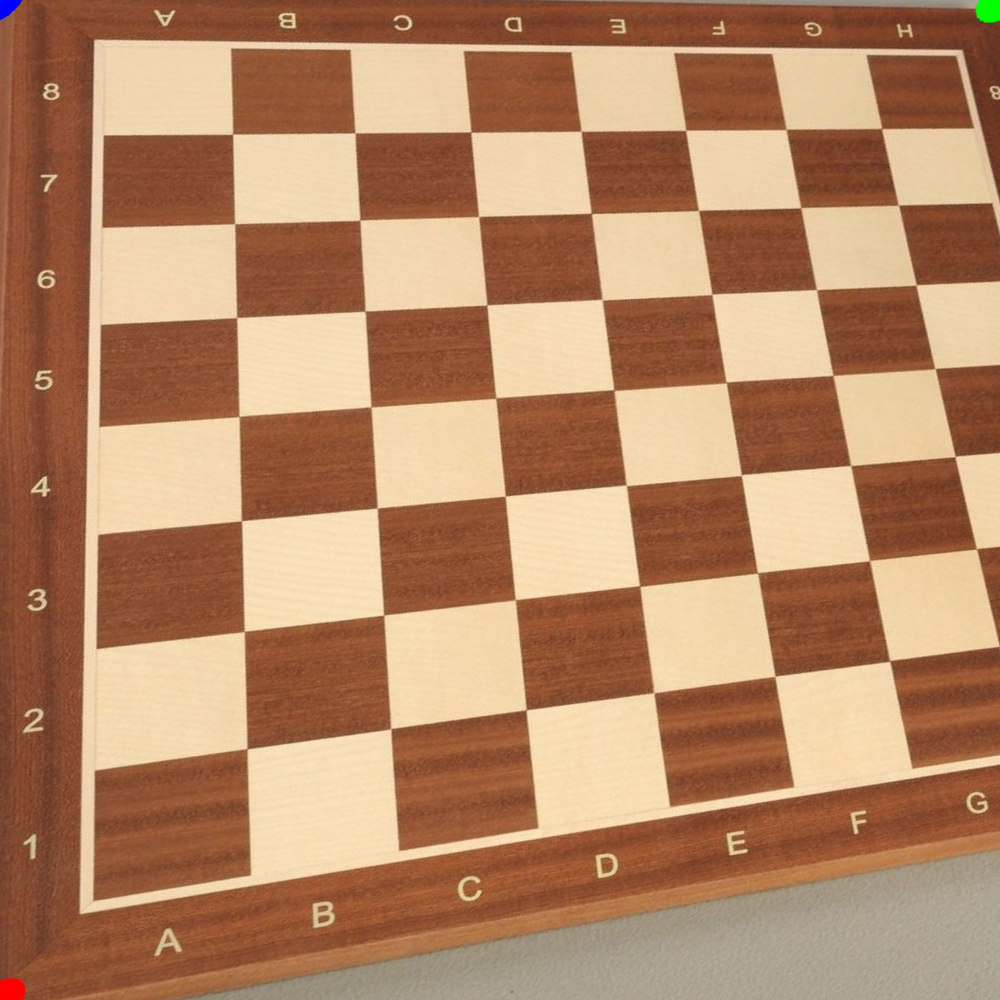

In [11]:
matrix = cv2.getAffineTransform(pts1[:3].astype(np.float32), pts2[:3])
dst = cv2.warpAffine(src, matrix, (1000,1000))
show(dst)

## 투시 변환

이제 투시 변환이라는 것도 있는데 투시 변환은 아핀 변환보다도 더 잘 되거든요.

아핀 변환보다 더 자유도가 높은 겁니다

왜 이름이 투시 변환이냐면 우리가 이제 어떤 사각형이 있는데 이 사각형을 옆에서 이렇게 보면 뭐 이런 식으로 보일 거 아니에요 각도를 달리하면 보는 시점을 변환하면 거기에 따라서 어떻게 변환을 할 수 있기 때문에 투시 변환이라고 합니다

그래서 이제 투시 변환은 아핀 변환을 포함을 해요 투시 변환이 아핀 변환보다 더 큰 개념입니다

일반적인 우리가 이미지를 가지고 하는 작업은 아핀 변환으로 할 수 있는데 가끔 어떤 경우가 있냐면 예를 들어서 이렇게 체스판이 있는데 이 체스판을 위에서 본 것처럼 바꾸고 싶어요

그러면은 시점을 바꾸는 거죠

시점을 바꾸려면 투시 변환을 해야 된다

그래서 미리 결과를 보여드리면 투시 변환을 하면 이 이미지를 가지고 이렇게 바꿀 수가 있습니다

위에서 본 것처럼 그래서 갤럭시는 그게 되는지 모르겠는데 아이폰인가 아이패드에 나온 신기능 중에 그런게 있거든요

화상 통화를 하는데 웹캠을 켜고 화상 통화를 하는데 내 책상에 있는 거를 마치 내가 책상에 있는 거를 막 이렇게 책상 위에서 이렇게 찍은 것처럼 보여주는 기능이 있어요

근데 어떻게 했겠습니까?

뭐 이런 식으로 했겠죠

그래서 웹캠의 화각을 굉장히 넓게 잡아 가지고 이 책상을 찍은 다음에 책상을 푸시 변환 같은 걸 해서 변환을 하면 마치 책상을 위에서 찍은 것처럼 나는 사실 웹캠은 위에서 찍은 게 아니라 정면에 있는 건데 정면에 있는 웹캠으로 찍은 거를 마치 이렇게 유튜브 같은 데 보면 제품 리뷰 이런 거 보면 카메라 매달아서 위에서 찍잖아요

그렇게 한 것처럼 변환을 할 수 있습니다

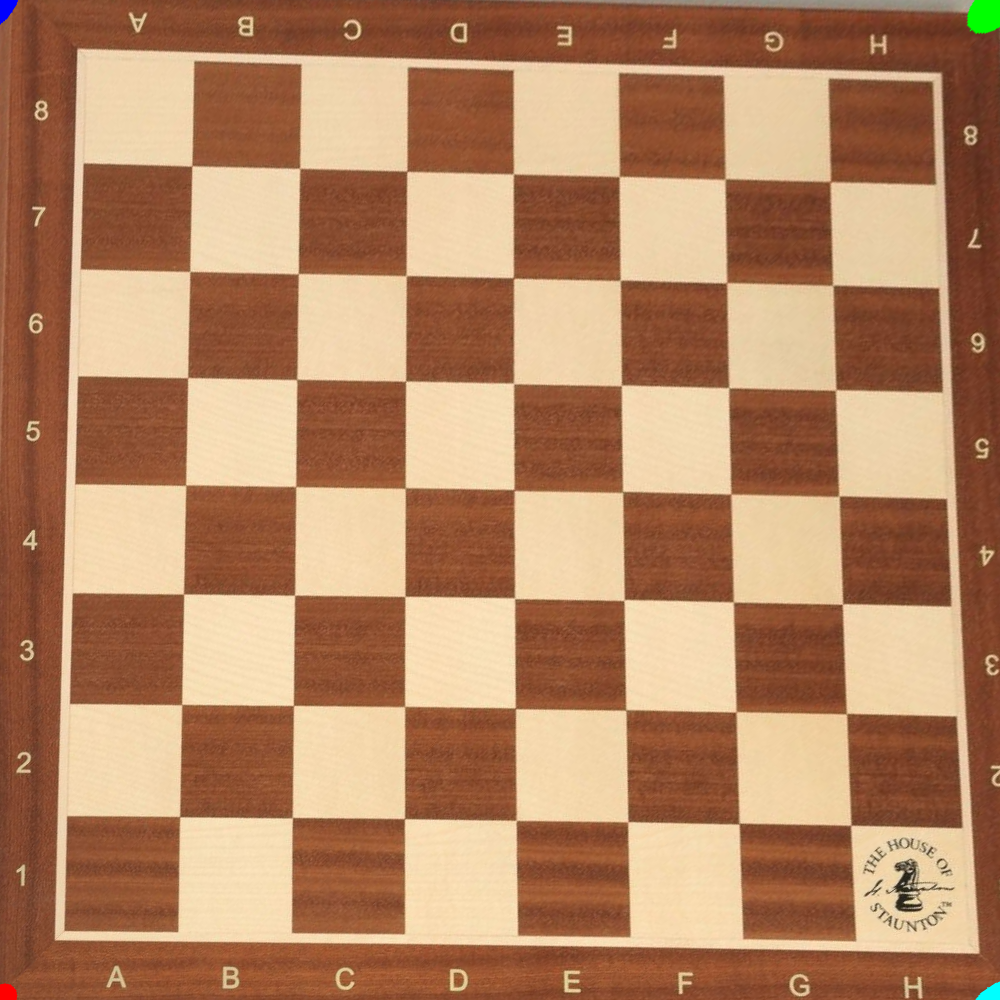

In [12]:
matrix = cv2.getPerspectiveTransform(pts1.astype(np.float32), pts2)
dst = cv2.warpPerspective(src, matrix, (1000,1000))
show(dst)

## 크기 변경

In [13]:
h, w = image.shape[:2]
w, h

(1200, 800)

In [14]:
aspect = w / h  # 가로 세로 비율
aspect

1.5

In [15]:
ratio = 0.5
new_w = int(w * ratio)
new_h = int(new_w / aspect)
new_w, new_h

(600, 400)

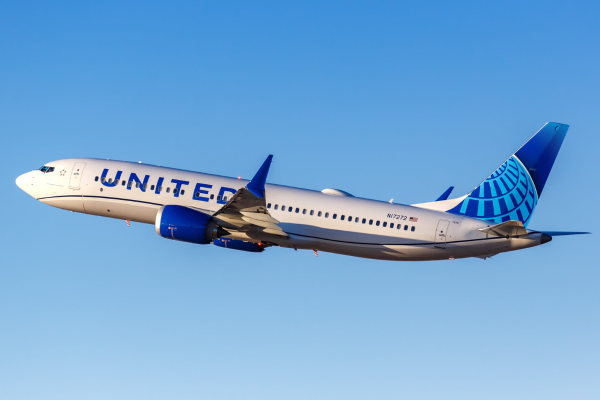

In [16]:
show(cv2.resize(image, (new_w, new_h)))

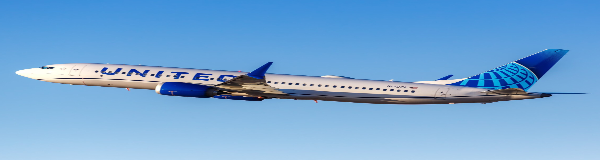

In [17]:
small = cv2.resize(image, None, fx=0.5, fy=0.2)  # 가로는 절반, 세로는 20%
show(small)


이런 얘기가 되고요 그 다음에 이제 우리가 일일이 이렇게 계산을 하는 대신에 여기 이제 보시면은 여기 크기를 주는 부분인데 크기를 주는 부분을 none n은 대문자로 쓰셔야 됩니다

none 해가지고 생략을 해 버리고 fx랑 fy를 주면은 이게 뭐냐면 가로의 비율 세로의 비율이 됩니다

우리가 직접 계산할 필요 없이 가로는 0.5를 곱하고 그럼 반이 되는 거죠

세로는 0.2를 곱하고 그럼 오 분의 일이 되겠죠

이렇게 해라 그러면은 우리가 준 비율대로 가로는 반으로 줄이고 세로는 50%로 줄여서 이렇게 받게 돼요.

그래서 그냥 뭐 귀찮은 계산하기 귀찮으시면 fx랑 fy 값을 주시면 고 비율대로 알아서 이제 조정을 하게 됩니다

그래서 이제 리사이즈를 이용해서 크기를 조정을 할 수 있다

## 보간

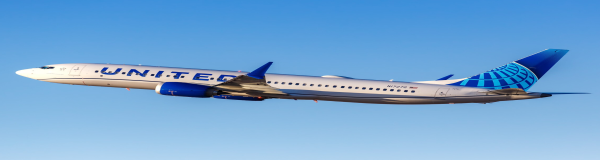

In [18]:
small = cv2.resize(image, None, fx=0.5, fy=0.2, interpolation=cv2.INTER_AREA)
show(small)

여기서 이제 한번 보시면은 여기 보면은 이렇게 하시면은 여기 보면은 지금 보시면은 이제 이렇게 하시면은 여기 보면은 지금 보시면은 여기 보면은 자글자글 깨져 가지고 보기가 싫죠

왜 이렇게 나오냐면 이게 이제 보간이라는 거를 해야 되는데 보간을 안 해서 그래요

그래서 이미지를 확대하거나 축소할 때 이게 기본적으로 점이기 때문에 크기가 달라지면 점의 개수가 딱 맞아떨어지지 않습니다

그래서 이제 확대하거나 축소할 때 그 어떻게 보간을 하느냐 확대를 하면 이제 보통 확대를 할 때는 요 앞에 있는 네 가지를 쓰고 축소를 할 때는 요걸 쓰는데 확대를 할 때는 우리가 이제 점이 이렇게 있으니까 이거를 그대로 키워 버리면 점이 그냥 이만한 깍두기처럼 이렇게 되거든요

그래서 여기를 점진적으로 색깔이 변하게 해야 되는데 그래서 이제 보간을 합니다

보간이라는 건 뭐냐면 여기 두 개 픽셀에 있는 밝기를 이용해서 가운데 있는 픽셀의 밝기를 예를 들면 여기는 어둡고 여기는 밝으면 여기는 약간 회색으로 채워 주면 되겠죠

그래서 이제 그런 식으로 새로운 새로 생기는 픽셀들을 메꿔 주는데 메꿀 때 이제 니어리스트 리니어 큐백 이건 뭐라고 읽는지 잘 모르겠는데요

하여간 이렇게 하면은 더 많은 픽셀을 고려를 하는 거예요

더 많은 픽셀을 고려하면 좀 더 색깔이 자연스럽게 변하겠죠

그 다음에 이제 축소를 할 때는 이제 인터에리어 이렇게 하는데 요거를 이제 적용을 해서 해 보시면은 요거 위에 거랑 비교해 보면 위에 거는 지금 되게 날개 이런 데 굉장히 우들투들하게 그냥 다짜고짜 변환을 하게 되죠

변환할 때 보간을 안 하기 때문에 굉장히 우들투들 우들투들하게 이런 데 꼬리날개 이런 데도 보시면 굉장히 우들투들하게 그 이미지가 축소가 됩니다

여기서는 화질이 좀 떨어지긴 하지만 훨씬 더 매끄럽게 색깔이 변하거든요

그래서 이게 이제 보간을 해 가지고 좀 더 매끄럽게 변하도록 한 거죠

그래서 리사이즈를 하실 때는 요 보간을 어떻게 할지를 지정을 해 주시는 게 좋다

## 마우스 커서가 있는 좌표 보기

In [134]:
dup = image.copy()
def click(event, x, y, *args):
    global dup
    if event == cv2.EVENT_MOUSEMOVE:
        dup = image.copy()
        if x > dup.shape[1] / 2:
            x -= 150
        cv2.putText(
            dup, f'{x},{y}', 
            org=(x, y), 
            fontFace=cv2.FONT_HERSHEY_SIMPLEX, 
            fontScale=1, 
            color=(0, 0, 255), 
            thickness=2)
while True:
    cv2.imshow('image', dup)
    cv2.setMouseCallback('image', click)
    if cv2.waitKey(100) == ord('q'):
        break
cv2.destroyAllWindows()

## 리매핑

그 다음에 리맵핑이라는 게 있는데 이거는 뭐냐면 점들의 좌표를 미리 지정을 해놔가지고 이 점은 이 좌표로 옮겨라

이 점은 이 좌표로 옮겨라

이거를 미리 해서 거기로 옮겨주는 거예요

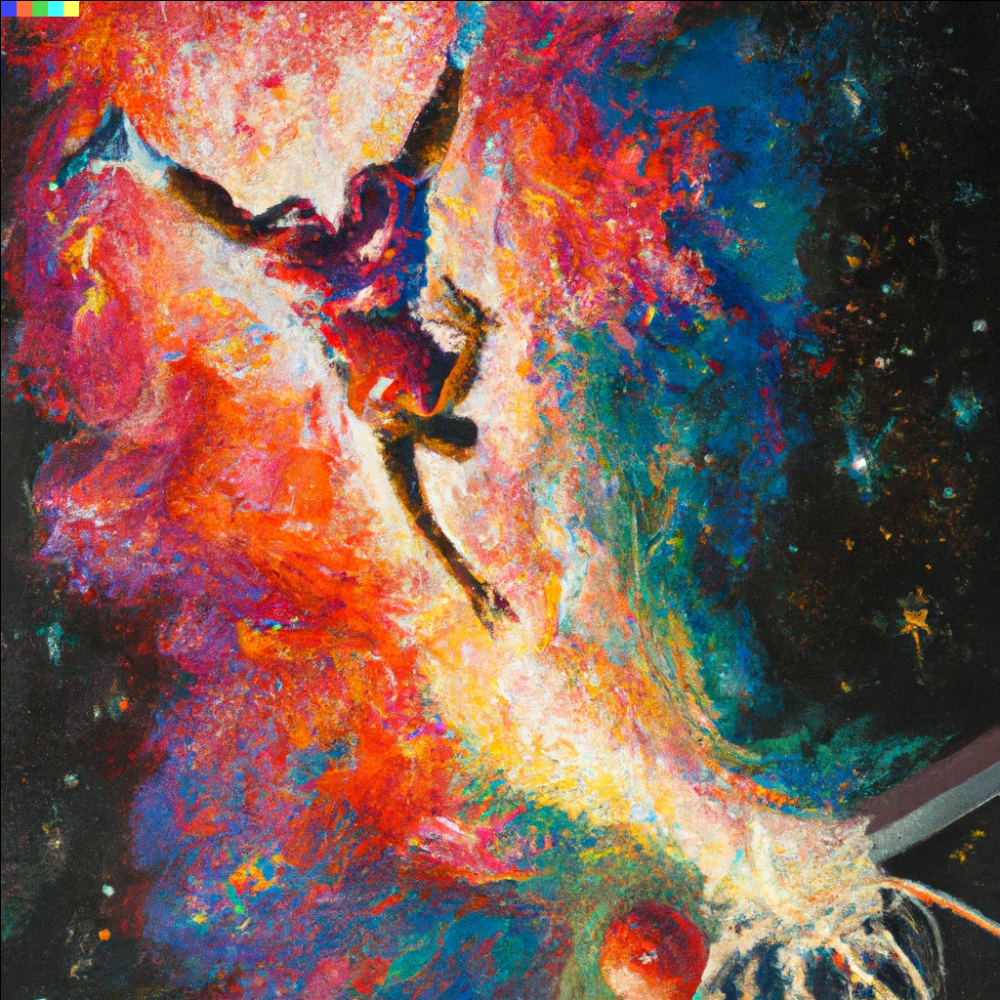

In [ ]:
src = cv2.imread('basketball.webp')
height, width = src.shape[:2]  # 이미지의 높이, 너비
mapy, mapx = np.indices((height, width),dtype=np.float32)  # 원래의 좌표
mapx = width - mapx # 좌우 대칭
mapy = height - mapy  # 상하 대칭
dst = cv2.remap(src, mapx, mapy, cv2.INTER_LINEAR)  # 점들의 좌표를 바꿈
show(dst)

그래서 여기 이제 basketball.wp 파일을 열어가지고 이미지의 높이랑 폭을 구한 다음에 여기 map y, map x 이렇게 해서 이거를 원래 예를 들면 0코만 일단 돌리고 나서 보죠

그래서 map x를 보면은 이게 실수로 나오는데 이게 이제 그 0, 0에 있던 거를 1024, 1024로 옮기고 이런 식으로 좌표를 다 이제 어느 점에 있는 좌표를 어느 점으로 옮길지를 다 지정을 해놓는 거예요

그래서 그거를 원래 map y는 여기까지만 하면 원래 map x는 첫 번째 점은 0, 0에 있었고 두 번째 점은 1, 0에 있었고 세 번째 점은 2, 0에 있었는데 이거를 이제 변환을 이렇게 해주면 가로폭에서 그 x 자기 자신의 좌표를 빼면 지금 0, 0은 1024 빼기 0으로 가니까 빼기는 뭐였죠?

빼기는 아니어도 될 거 같은데 빼기는 아니어도 될 거 같은데 그러면 0, 0에 있던 거는 이렇게 계산하면 1024로 가고 0에 있던 건 1024로 가고 1에 있던 거는 뭐 1023으로 가고 뭐 이런 식으로 좌표가 다 바뀌겠죠

그래서 어떤 좌표로 바꿀지를 미리 지정을 해놓으면은 우리가 이제 이렇게 하면은 이제 좌우대칭이랑 상하대칭을 하게 되는데 아니 뭐 그냥 좌우대칭 상하대칭 하면은 뭐 이렇게 번잡하게 합니까?

라고 하실 수도 있는데요 이거를 어떻게 응용할 수 있냐면 우리가 아까 봤던 예를 들면 책 같은 게 이렇게 휘어있는 그런 경우에 그걸 평평하게 펼치려면은 그냥 아핀 변환이나 투시 변환으로 안되고 이제 책이 이렇게 휘어있잖아요

그럼 휘어진 거를 이렇게 빤빤하게 펼치려면 요거는 여기로 보내고 요거는 여기로 보내고 요거는 여기로 보내고 요거는 여기로 보내고 요거는 여기로 보내고 요거는 여기로 보내고 이거를 각각 좌표를 점들의 좌표를 어떻게 움직일지를 다 계산을 해가지고 표로 만들어 놔야 이런 거를 이제 변환을 할 수 있습니다

일반적인 투시 변환으로 안 되는 문제로 가면은 이렇게 리맵핑을 해가지고 하나하나 다 옮겨줘야 됩니다

그래서 이제 여기서부터는 되게 복잡하게 되겠죠

왜냐면 우리가 좌표를 다 계산을 할 수 있어요

우리가 좌표를 다 계산을 할 수 있어요

In [78]:
mapy, mapx = np.indices((height, width), dtype=np.float32)  # 원래의 좌표
# -1~1로 정규화된 좌표로 변경
center_x, center_y = width // 2, height // 2  # 중심 좌표 설정
norm_mapx = (mapx - center_x) / (width // 2)
norm_mapy = (mapy - center_y) / (height // 2)
r, theta = cv2.cartToPolar(norm_mapx, norm_mapy) # 극좌표계로 변환

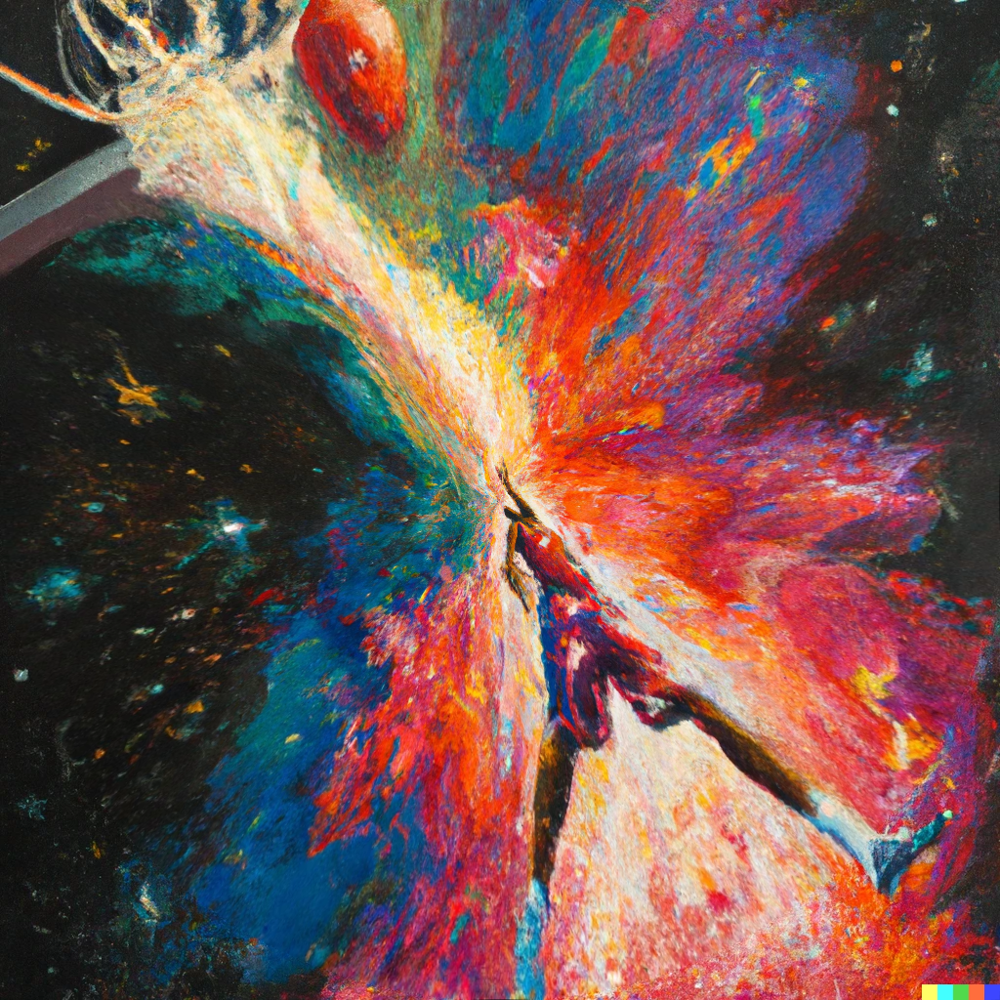

In [81]:
exp = 0.5  # 볼록, 오목 지수 (오목 < 1 < 볼록)
scale = 1 # 적용 영역 반지름 (0 ~ 1)
r[r< scale] = r[r<scale] ** exp   # 왜곡 영역만 중심확대/축소 지수 적용
norm_mapx, norm_mapy = cv2.polarToCart(r, theta)  # 직교좌표계로 변환
# 정규화된 좌표를 이미지 좌표로 변경
mapx = norm_mapx * (width // 2) + center_x
mapy = norm_mapy * (height // 2) + center_y
dst = cv2.remap(src, mapx, mapy, cv2.INTER_LINEAR)
show(dst)

그래서 우리가 이제 이런 책이 휘어있는거 변환하는거는 좀 복잡하니까 그거는 건너뛰고 좀 간단한걸 해볼 건데 뭘 해볼거냐면 이제 볼록오목변환 이렇게 얘기했는데 그 돋보기효과 같은 것을 해볼거야

그래서 돋보기로 하면은 이렇게 확대가 되고 오목렌즈로 하면은 오목해지고 뭐라고 해야되죠

오목렌즈로 하면은 오목해지고 그거를 할 수 있는데 똑같이 리맵핑으로 할 수 있습니다 블록렌즈로 하면 어떻게 해요?

원래 이미지가 이렇게 있으면 이쪽에 중심이 이렇게 있으면 중심 근처에 있는 애들은 약간 멀리 옮겨주고 그 다음에 여기 있는 애들은 또 멀리 옮겨주고 여기 있는 애들은 더 멀리 옮겨주고 이런 식으로 점들을 바깥쪽으로 바깥쪽으로 밀어서 보내면 되잖아요

그래서 그거를 수학적으로 계산을 해가지고 여기 보시면 이게 반지름 R이 반지름인데 반지름에다가 EXP만큼 승을 해주는데 EXP가 1이면 1승을 하니까 자기 자신이랑 똑같게 됩니다

그럼 반지름이 변하지 않겠죠

근데 예를 들면 이걸 2로 해주면 제곱을 해주니까 원래 1이었던 건 계속 1인데 2였던 건 4가 되고 3이었던 건 9가 되고 4였던 건 16이 되고 이렇게 확 커진단 말이에요

그리고 반대로 반지름이 1분의 2다

그럼 루트 씌워주는 거랑 똑같으니까 반대로 16이었던 거는 4가 되고 9였던 거는 3이 되고 이런 식으로 변환을 하게 됩니다

그래서 이거를 한번 해보면 이제 이거는 원래의 좌표를 가져오고 이거를 우리가 극좌표계로 변환을 하는데 극좌표계계는 뭐냐면 원래는 XY인데 이걸 가지고 볼록 오목 변환을 하려면 계산이 복잡해요

그래서 극좌표계계는 뭐냐면 여기 중심에서 보세요 이 각도하고, 0도부터 360도까지 있겠죠?

각도하고 거리로 변환을 하는 거예요

그러면은 이게 이제 볼록렌즈 같은 걸 끼우면은 각도는 똑같은데 이 R만 늘어난단 말이에요

그리고 오목렌즈에다 끼우면 각도는 똑같은데 반지름만 이렇게 줄어든다고 그리고 반지름을 변환한 다음에 다시 X랑 Y로 변환을 하면 좌표를 계산할 수 있겠죠

그래서 R이랑 세타, 세타가 이제 각도고 R이 반지름인데 우리가 이제 1.5로 하면은 1일 때는 원래 그대로 R의 1승이니까 R이 그대로 있고 1.5로 하면은 R의 1.5승 해서 볼록하게 변환이 됩니다

그래서 쇼우 DST에서 보면은 여기에 마치 볼록렌즈를 적용한 것처럼 이런 식으로 보여주게 되죠

그리고 여기 여기 R을 1.5가 아니라 0.7 이렇게 하면은 반대로 눈에는 별로 안 뜨는데 0.7 말고 한 0.5 이렇게 볼까요?

오목렌즈를 적용한 것처럼 이렇게 되죠

그래서 왜 핸드폰으로 사진을 찍을 때 보통 어떻게들 많이 하시냐면은 핸드폰 사진을 찍을 때 이제 사람이 이렇게 나오도록 찍잖아요

근데 이렇게 하면은 사실 그렇게 예쁘게 잘 안 찍히거든요

그래서 이제 사진을 잘 찍는 방법 중에 하나가 사람 얼굴을 여기다 놓고 이런 식으로 찍으면은 얼굴은 좀 작게 나오고 렌즈에 어떤 왜곡이 있기 때문에 여기 바깥으로 갈수록 스마트폰 카메라가 바깥으로 갈수록 이렇게 확대돼서 나오기 때문에 이렇게 하면 다리가 길어 보이게 뭐 이런 식으로 어...

찍는 거죠

그래서 이제 셀카나 이런 거 사진 잘 찍으시는 분들은 똑같은 사람을 찍어도 이렇게 좀 다리는 길고 얼굴은 작게 보이게 이렇게 렌즈의 특성을 이용을 해서 찍는 거죠

근데 우리가 렌즈의 특성을 이용해서 찍어도 되지만 이렇게 사후적으로 이렇게 하면 이제 얼굴은 작고 다리는 길게 왜냐하면은 이제 오목렌즈 변환을 적용을 해가지고 가운데는 이렇게 줄어들고 가운데가 줄어드니까 상대적으로 바깥쪽이 늘어나겠죠

그래서 여기 이 EXP를 조절을 해가지고 우리가 블록 렌즈 오목렌즈로 변환을 할 수 있다

이런 얘기입니다

그래서 우리가 이제 행렬 변환 형태로 할 수 없는 투시 변환 형태로 할 수 없는 변환도 우리가 이제 리맵핑을 이용하면은 변환을 할 수 있다

이런 얘기죠

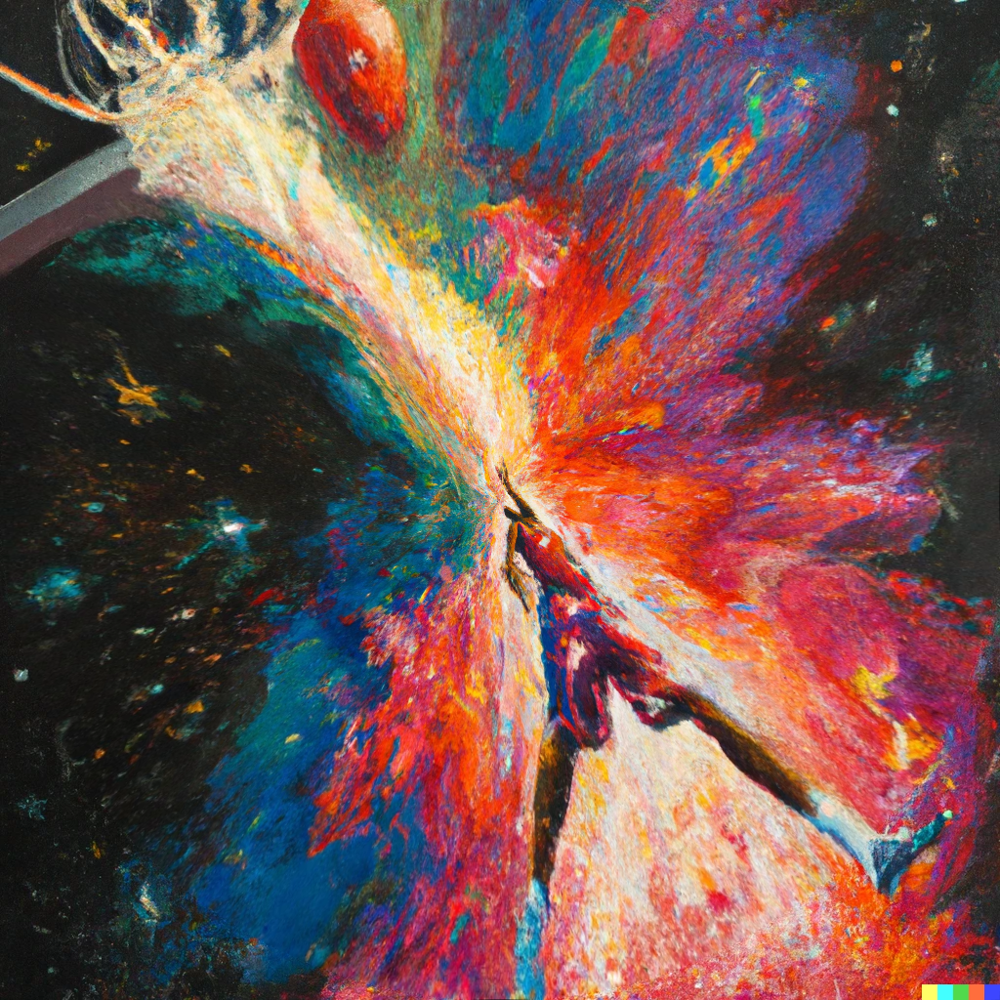

In [86]:
Image.fromarray(dst[:, :, ::-1]) # == show

그래서 어제 show 함수를 쓰셨어도 오늘 되면 파이썬이 이 show 함수를 몰라요

우리가 매번 정의를 해줘야만 얘가 show 함수를 쓸 수 있거든요

그래서 이제 질문이 오늘도 한 두 분 정도가 물어보셨는데 show 함수 매번 정의해야 되냐

이런 걸 물어보셨는데요 매번 정의하기가 귀찮다 그러면은 그냥 이미지점 from array를 하시면 됩니다

근데 이제 문제가 뭐냐면 이미지점 from array 하면은 색깔이 RGB랑 BGR이랑 순서가 반대라서 색깔만 뒤집혀 나오거든요

이건 이제 마음의 눈으로 보시면 돼요

파란색은 빨간색이고 빨간색은 파란색이구나

이렇게 하시면 되는데 우리가 그렇게 하려면 또 불편하잖아요

그럼 여기다가 그냥 cv2.cvtcolor 이렇게 하셔가지고 그냥 한 줄로 이렇게 그냥 타이핑 하셔도 됩니다

결국에는 show 함수가 하는 일이 BGR을 RGB로 바꿔주고 그 다음에 이미지로 변환하는 게 다거든요

그래서 한 줄로 치셔도 되는데 매번 이거를 쓰시려면 되게 번잡하잖아요

그죠

그래서 이제 show 함수를 쓰는 거고 사실은 여기 cv2.cvtcolor 함수를 안쓰고 사실은 여기 cv2.cvtcolor 함수를 안쓰고 사실은 여기 cv2.cvtcolor 함수를 안쓰고 안 써도 되긴 합니다

왜냐면 순서만 바꾸는 거라서 사실 더 간단하게 할 수도 있는데 이게 아닌가

아 사실은 한 줄로 간단하게 쓰시려면은 이렇게만 쓰셔도 되고 이렇게만 쓰셔도 되거든요

여기 이제 이 뒷부분에 이게 무슨 얘기냐면 땡땡은 그냥 전부 이런 뜻입니다

그래서 DST의 가로는 전부 세로도 전부 그 다음에 이제 마지막에 채널인데 땡땡 땡땡 마이너스 1은 뭐냐면 채널을 역순으로 해라

이런 얘기입니다

그러면 BGR이니까 채널을 역순으로 하면 RGB가 되겠죠

그래서 이제 파이썬을 좀 잘 하시면 그냥 이렇게 한 줄 쓰셔도 돼요

이거랑 이제 쇼우는 똑같이 써도 돼요

## 배경 자르기

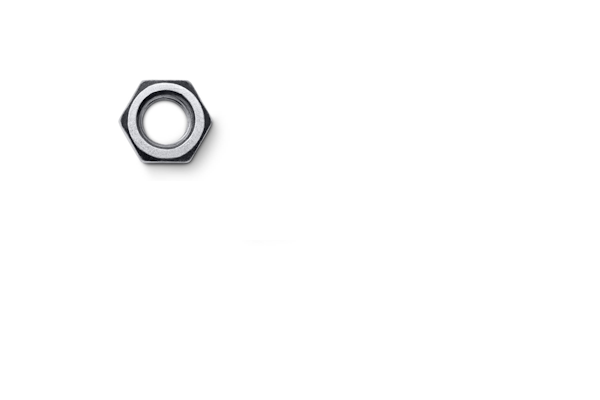

In [87]:
src = cv2.imread('nut.png')
show(src)

이렇게 하면은 이제 흰 바탕에 이렇게 나사가 하나 이렇게 있거든요

우리가 이제 뭘 하고 싶냐면

지금까지는 그냥 이미지 전체를 회전을 시키거나 뭐 돌리거나 뒤집거나 뭐 이런 걸 했는데 그게 아니고 나사 부분만 이렇게 잘라내고 싶어요

여기 뒤에는 배경이니까 쓸데없는 거잖아요

나사만 이렇게 잘라내고 싶은데 그럼 어떻게 하면 되냐면 나사 있는 데만 이렇게 자르면 됩니다

In [90]:
bg_color = src[0, 0]
bg_color

array([255, 255, 255], dtype=uint8)

In [96]:
error = 10
low = np.where(bg_color > error, bg_color - error, 0)
high = np.where(bg_color < 255 - error, bg_color + error, 255)
low, high

(array([245, 245, 245], dtype=uint8), array([255, 255, 255], dtype=uint8))

일단 이제 이미지를 불러오고요 그 다음에 SRC에 0,0 그러면 이제 왼쪽 상단 픽셀이 됩니다

그래서 BG 컬러를 보면은 뭐 흰색이 나오겠죠

그래서 BG 컬러는 SRC에 0,0 그래서 이제 BG 컬러를 보면은 흰색이 됩니다

255 255 255 BGR이 전부 최대의 반성입니다

그래서 이제 BG 컬러를 보면은 흰색이 됩니다

255 255 255 BGR이 전부 최대의 반성입니다 최대의 밝기로 돼 있으면 모든 색깔이 최대 밝기로 섞이면 가장 밝은 흰색이 됩니다

그래서 우리는 흰색을 다 날려버릴 건데 이게 이제 이미지가 아주 깔끔하게 찍히면 상관없는데 좀 플러스 마이너스가 있단 말이에요

완전히 희지 않고 약간 어둡거나 이럴 수도 있습니다

예를 들면 요런데 그림자가 있으면 그림자도 살짝 흰색인데 살짝 어두우니까 정확하게 255는 아니고 뭐 얼마가 되겠죠

그래서 에러를 우리가 10 이렇게 했는데 한 플러스 마이너스 10까지는 되겠죠?

한 플러스 마이너스 10까지는 내가 봐주겠다

이런 거에요

그런 것도 다 잘라내겠다

그러니까 한 245도 잘라낸다는 얘기죠

In [114]:
bg_color + 10

array([9, 9, 9], dtype=uint8)

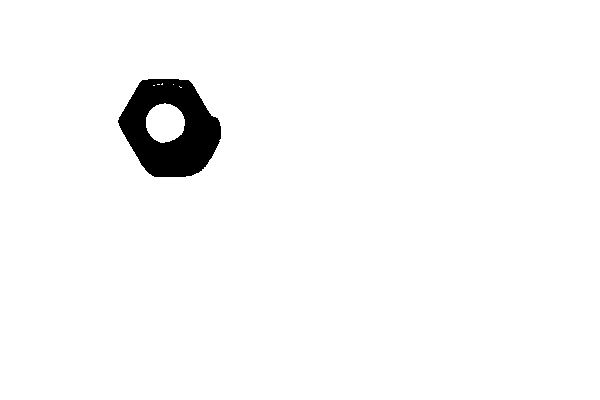

In [97]:
mask = cv2.inRange(src, low, high)   # 배경색과 유사한 색상 검출
Image.fromarray(mask)

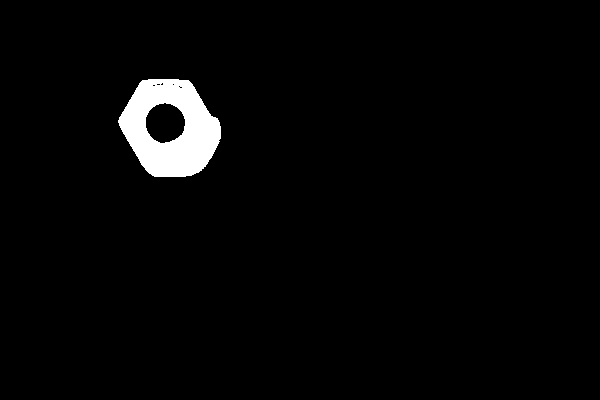

In [98]:
mask_inv = cv2.bitwise_not(mask)  # 배경색이 아닌 부분 검출
Image.fromarray(mask_inv)


그래서 이제 이렇게 찾을 수가 있고요 그래서 이제 이렇게 하면은 배경색하고 유사한 색상을 이제 검출을 할 수가 있습니다

그다음에 이제 마스크 imv 하면은 반대로 반대로 뒤집습니다

인벌트 인벌트 인벌트를 하나 한 대 이것도 언더바 imv 해서 보면은 이건 이제 반대로 그냥 색을 뒤집은 거예요

흰색이던건 검은색으로 검은색이던건 흰색으로 이렇게 뒤집으면은 검은색인 부분은 제로가 되겠죠

제로가 되고 흰색인 부분은 숫자가 있는 부분이 됩니다

그래서 이제 이제 이렇게 가운데에 있는 이 부분을 이제 이렇게 뒤집으세요

그러면은 이 부분을 이제 이렇게 뒤집으세요

그래서 이제 이렇게 뒤집으세요

In [99]:
coords = cv2.findNonZero(mask_inv)  # 실제 그림이 있는 좌표 추출
coords

array([[[148,  79]],

       [[149,  79]],

       [[150,  79]],

       ...,

       [[183, 176]],

       [[184, 176]],

       [[185, 176]]], dtype=int32)

find none zero는 말 그대로 0이 아닌데를 찾아라 그 좌표가 어디냐

이런 얘기예요

그러면 0이 아닌 점들이 있는 이 하얀 점들이 있는 모든 좌표를 다 찾아줍니다

In [100]:
x, y, w, h = cv2.boundingRect(coords) # 사각형으로 경계 추출
trimmed = src[y:y+h, x:x+w] # 실제 그림 부분만 자름


그러면 흰색들의 좌표를 다 찾아주는데 사실 우리가 필요한 건 이 흰색들의 좌표를 다 아는 게 아니고 이 쪽 끝 양쪽 끝 위 아래 이거의 좌표만 있으면 된단 말이에요

그래야 이미지를 자를 거니까 그래서 어떻게 하면 되냐면 여기 바운딩 넥트 함수에다가 이 좌표가 있는 거예요

이 좌표들을 넣어주면 이 좌표들 중에 맨 왼쪽 거는 X가 되고 맨 아래 거는 맨 위에 거는 Y가 됩니다

그리고 가로폭하고 세로 H가 이렇게 나오게 돼요

사실 뭐 간단하겠죠

여기서 X 중에서 제일 작은 거 찾고 Y 중에서 제일 작은 거 찾고 그 다음에 X 중에 제일 큰 거 찾고 Y 중에 제일 큰 거 찾아서 이렇게 빼주면 가로폭 세로폭이 나오잖아요

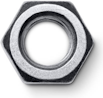

In [101]:
show(trimmed)